# Config

In [ ]:
import os

class Config:
    def __init__(self):
        self.BASE_PATH = '/kaggle/input/selfie2anime/'
        self.SAVE_PATH = '/kaggle/working/model_checkpoints/'
        self.LEARNING_RATE = 1e-5
        self.BETAS = (0.5, 0.999)
        self.BATCH_SIZE = 32
        self.LAMBDA = 3

config = Config()
os.mkdir(config.SAVE_PATH)

# Dataset

In [ ]:
from torch.utils.data import Dataset
from torchvision import transforms
import torch
from PIL import Image
import os
import numpy as np


def process_img_to_show(image: torch.Tensor) -> np.ndarray:
    image = image.detach().cpu().numpy()
    # scale from 0 to 255
    image = ((image - image.min()) * 255) / (image.max() - image.min())
    image = image.transpose(1, 2, 0).astype(np.uint8)

    return image


class ImageDataset(Dataset):
    def __init__(self, images_path: str,
                 in_channels: int = 3,
                 image_size: int = 128) -> None:
        # Getting list of paths to images
        images_dir = os.path.join(config.BASE_PATH, images_path)
        dir_list = os.listdir(images_dir)
        self.images_path = [
            os.path.join(images_dir, image) for image in dir_list
        ]

        self.transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5] * in_channels,
                                 std=[0.5] * in_channels)
        ])

    def __len__(self) -> int:
        return len(self.images_path)

    def __getitem__(self, key):
        if isinstance(key, slice):
            return [self[ind] for ind in range(key.start, key.stop)]
        image_path = self.images_path[key]
        image = Image.open(image_path).convert('RGB')

        image_transformed = self.transform(image)

        return image_transformed


class ImageBuffer:
    """
    Buffer of generated images, which gives generator some time
    to learn to fool the discriminator
    """

    def __init__(self, device: torch.device,
                 buffer_lim: int = 64, prob_threshold: float = 0.5):
        """
        :param buffer_lim: max size of buffer
        :param prob_threshold: probability of putting new image to buffer
        """
        self.buffer_lim = buffer_lim
        self.prob_threshold = prob_threshold
        self.buffer = torch.Tensor().to(device)

    def get_images(self, image_batch: torch.Tensor) -> torch.Tensor:
        """
        :param image_batch: current generated image barch
        :return: image batch after sampling from buffer
        """
        # initializing of buffer
        if len(self.buffer) < self.buffer_lim:
            self.buffer = torch.cat((self.buffer, image_batch), 0)
            # just return the batch without doing anything
            return image_batch

        # if i-th prob is > threshold add i-th image to buffer
        prob = torch.rand(len(image_batch))
        mask = (prob > self.prob_threshold).int()
        new_images = image_batch[(mask == 1).nonzero().squeeze()]
        # replacing previous images with new images
        if len(new_images) != 0:
            # using random permutation to choice without replacement
            ind_to_rpl = torch.randperm(self.buffer_lim)[:len(new_images)]
            self.buffer[ind_to_rpl] = new_images

        # sampling images from buffer
        ind = torch.randperm(self.buffer_lim)[:len(image_batch)]

        return self.buffer[ind]

        # TODO: replace len() with torch.size


# Generator

In [ ]:
import torch.nn as nn


class DownConvLayer(nn.Module):
    def __init__(self, in_channels: int, out_channels: int,
                 kernel_size: int, activation: bool = True, **kwargs):
        super().__init__()

        self.conv = nn.Sequential(
            nn.Conv2d(
                in_channels, out_channels, kernel_size,
                padding_mode='reflect', **kwargs
            ),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU() if activation else nn.Identity()
        )

    def forward(self, x):
        return self.conv(x)


class UpConvLayer(nn.Module):
    def __init__(self, in_channels: int, out_channels: int,
                 kernel_size: int, activation: bool = True, **kwargs):
        super().__init__()

        self.conv = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels, out_channels, kernel_size, **kwargs),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU() if activation else nn.Identity()
        )

    def forward(self, x):
        return self.conv(x)


class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.resid = nn.Sequential(
            DownConvLayer(in_channels, in_channels, 3, padding='same'),
            DownConvLayer(
                in_channels, in_channels, 3, activation=False, padding='same'
            )
        )

    def forward(self, x):
        return x + self.resid(x)  # skip connection


class Generator(nn.Module):
    """
    Generator of CycleGAN model,
    architecture is the same as in the original paper
    """

    def __init__(self, in_channels: int = 3,
                 filters: int = 64,
                 num_resid: int = 6):
        super().__init__()
        self.down_conv0 = DownConvLayer(
            in_channels, filters, 7, padding=3, stride=1
        )
        self.down_conv1 = DownConvLayer(
            filters, filters * 2, 3, padding=1, stride=2
        )
        self.down_conv2 = DownConvLayer(
            filters * 2, filters * 4, 3, padding=1, stride=2
        )

        self.resid_blocks = nn.Sequential(
            *[ResidualBlock(filters * 4) for _ in range(num_resid)]
        )

        self.up_conv0 = UpConvLayer(
            filters * 4, filters * 2, 3, padding=1, stride=2, output_padding=1
        )
        self.up_conv1 = UpConvLayer(
            filters * 2, filters, 3, padding=1, stride=2, output_padding=1
        )

        self.last = nn.Sequential(
            nn.Conv2d(
                filters, in_channels, 7, stride=1,
                padding=3, padding_mode='reflect'
            ),
            nn.Tanh()
        )

    def forward(self, x):
        # downsampling
        x = self.down_conv0(x)
        x = self.down_conv1(x)
        x = self.down_conv2(x)

        # residual blocks
        x = self.resid_blocks(x)

        # upsampling
        x = self.up_conv0(x)
        x = self.up_conv1(x)

        x = self.last(x)

        return x


# Discriminator

In [ ]:
import torch.nn as nn
import torch.nn.functional as F
import torch


class ConvLayer(nn.Module):

    def __init__(self, in_channels: int, out_channels: int,
                 stride: int, **kwargs):
        super().__init__()

        self.conv = nn.Sequential(
            nn.Conv2d(
                in_channels, out_channels,
                kernel_size=4, padding=1,
                stride=stride, **kwargs
            ),
            nn.InstanceNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.conv(x)


class Discriminator(nn.Module):
    """
    Discriminator of CycleGAN model,
    architecture is the same as in the original paper
    """

    def __init__(self, in_channels: int = 3, filters: int = 64):
        super().__init__()

        self.conv0 = nn.Sequential(
            nn.Conv2d(
                in_channels, filters, kernel_size=4, stride=2, padding=1
            ),
            nn.LeakyReLU(0.2)
        )
        self.conv1 = ConvLayer(
            filters, filters * 2, stride=2,
        )
        self.conv2 = ConvLayer(
            filters * 2, filters * 4, stride=2,
        )
        self.conv3 = ConvLayer(
            filters * 4, filters * 8, stride=1
        )

        self.last = nn.Sequential(
            nn.Conv2d(
                filters * 8, 1, kernel_size=4, stride=1, padding=1
            ),
            nn.Sigmoid()  # we need a probabilities for each patch
        )

    def forward(self, x):
        # convolutions
        x = self.conv0(x)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)

        # probabilities for each patch
        x = self.last(x)

        return x


# CycleGAN

In [ ]:
import os
from tqdm import tqdm
from torch.utils.data import DataLoader
from torch.optim import Optimizer
import torch
import numpy as np
import matplotlib.pyplot as plt


class CycleGAN:
    """
    CycleGAN architecture consists of two Generators and two Discriminators
    """

    def __init__(self, device: torch.device,
                 in_channels: int = 3,
                 filters: int = 64,
                 num_resid: int = 6,
                 use_buffer: bool = True,
                 init_dir: str = None):
        self.device = device

        # generator from X to Y
        self.gen_XY = Generator(in_channels, filters, num_resid).to(device)
        # generator from Y to X
        self.gen_YX = Generator(in_channels, filters, num_resid).to(device)

        # discriminator X
        self.dis_X = Discriminator(in_channels, filters).to(device)
        # discriminator Y
        self.dis_Y = Discriminator(in_channels, filters).to(device)

        self.use_buffer = use_buffer
        if use_buffer:
            self.generated_x_buffer = ImageBuffer(self.device)
            self.generated_y_buffer = ImageBuffer(self.device)

        if init_dir:
            self.gen_XY.load_state_dict(
                torch.load(os.path.join(init_dir, 'gen_XY'))
            )
            self.gen_YX.load_state_dict(
                torch.load(os.path.join(init_dir, 'gen_YX'))
            )
            self.dis_X.load_state_dict(
                torch.load(os.path.join(init_dir, 'dis_X'))
            )
            self.dis_Y.load_state_dict(
                torch.load(os.path.join(init_dir, 'dis_Y'))
            )

    @staticmethod
    def cycle_consistency_loss(reconstructed: torch.Tensor,
                               real: torch.Tensor) -> torch.Tensor:
        """
        We want mapping (generators) F from X to Y and G from X to Y
        to be inverses to each other: F^(-1) = G and G^(-1) = F

        :param reconstructed: gen_YX((gen_XY(x))) for x images
                              and gen_XY((gen_YX(y))) for y images
        :param real: real image
        :return: L1 loss between real and reconstructed images
        """

        return torch.mean(torch.abs(real - reconstructed))

    def __discriminator_step(self, optimizers: dict[str, Optimizer],
                             x_batch: torch.Tensor,
                             y_batch: torch.Tensor) -> dict[str, float]:
        """
        :param optimizers: optimizers with weights from both discriminators
        :param x_batch:
        :param y_batch:
        :return: statistics for experiments
        """
        stats = {}
        # discriminator X
        optimizers['discriminator_x'].zero_grad()

        # teaching discriminator to detect real (from X) images
        real_x_preds = self.dis_X(x_batch)

        real_x_loss = torch.mean(
            (real_x_preds - 1) ** 2  # 1 is for the real (from X) images
        )

        # teaching discriminator to detect fake (not from X) images
        with torch.no_grad():
            generated_x = self.gen_YX(y_batch)
            if self.use_buffer:
                generated_x = self.generated_x_buffer.get_images(generated_x)

        generated_x_preds = self.dis_X(generated_x)

        generated_x_loss = torch.mean(
            (generated_x_preds - 0) ** 2
            # 0 is for the fake (not from X) images
        )

        # updating weights for discriminator
        loss_x = real_x_loss + generated_x_loss
        loss_x.backward()
        optimizers['discriminator_x'].step()

        # discriminator Y
        optimizers['discriminator_y'].zero_grad()

        # teaching Y discriminator to detect real (from Y) images
        real_y_preds = self.dis_Y(y_batch)
        real_y_loss = torch.mean(
            (real_y_preds - 1) ** 2  # 1 is for the real (from Y) images
        )

        # teaching discriminator to detect fake (not from Y) images
        with torch.no_grad():
            generated_y = self.gen_XY(x_batch)
            if self.use_buffer:
                generated_y = self.generated_y_buffer.get_images(generated_y)

        generated_y_preds = self.dis_Y(generated_y)

        generated_y_loss = torch.mean(
            (generated_y_preds - 0) ** 2
            # 0 is for the fake (not from Y) images
        )

        # updating weights for discriminator
        loss_y = real_y_loss + generated_y_loss
        loss_y.backward()
        optimizers['discriminator_y'].step()

        stats['x_loss'] = loss_x.item()
        stats['y_loss'] = loss_y.item()

        return stats

    def __generator_step(self, optimizer: Optimizer,
                         x_batch: torch.Tensor,
                         y_batch: torch.Tensor) -> dict[str, float]:
        """
        :param optimizer: optimizer with weights from both generators
        :param x_batch:
        :param y_batch:
        :return: statistics for experiments
        """

        stats = {}

        optimizer.zero_grad()

        # generator from X to Y

        # teaching generator to 'fool' discriminator
        generated_y = self.gen_XY(x_batch)
        generated_y_preds = self.dis_Y(generated_y)

        generated_y_loss = torch.mean(
            (generated_y_preds - 1) ** 2  # 1 is for the real (from Y) images
        )

        # calculating cycle consistency loss
        consistency_loss_x = self.cycle_consistency_loss(
            self.gen_YX(generated_y), x_batch
        )

        # generator from Y to X

        # teaching generator to 'fool' discriminator
        generated_x = self.gen_YX(y_batch)
        generated_x_preds = self.dis_X(generated_x)

        generated_x_loss = torch.mean(
            (generated_x_preds - 1) ** 2  # 1 is for the real (from X) images
        )

        # calculating cycle consistency loss
        consistency_loss_y = self.cycle_consistency_loss(
            self.gen_XY(generated_x), y_batch
        )

        loss = (
                generated_y_loss
                + generated_x_loss
                + config.LAMBDA * consistency_loss_x
                + config.LAMBDA * consistency_loss_y
        )

        loss.backward()
        optimizer.step()

        stats['loss'] = loss.item()

        return stats

    def save_weights(self, save_dir: str):
        os.mkdir(save_dir)
        torch.save(
            self.dis_X.state_dict(),
            os.path.join(save_dir, 'dis_X')
        )
        torch.save(
            self.dis_Y.state_dict(),
            os.path.join(save_dir, 'dis_Y')
        )
        torch.save(
            self.gen_XY.state_dict(),
            os.path.join(save_dir, 'gen_XY')
        )
        torch.save(
            self.gen_YX.state_dict(),
            os.path.join(save_dir, 'gen_YX')
        )

    def __show_images(self, test_dataset_x: ImageDataset,
                      test_dataset_y: ImageDataset):
        ind_x = np.random.randint(low=0, high=len(test_dataset_x))
        ind_y = np.random.randint(low=0, high=len(test_dataset_y))

        image_x = test_dataset_x[ind_x]
        image_y = test_dataset_y[ind_y]
        generated_y = self.gen_XY(image_x.to(self.device))
        generated_x = self.gen_YX(image_y.to(self.device))

        fig, ax = plt.subplots(2, 2)
        ax[0][0].imshow(process_img_to_show(image_x))
        ax[0][0].axis('off')
        ax[0][1].imshow(process_img_to_show(generated_y))
        ax[0][1].axis('off')
        ax[1][0].imshow(process_img_to_show(image_y))
        ax[1][0].axis('off')
        ax[1][1].imshow(process_img_to_show(generated_x))
        ax[1][1].axis('off')

        plt.show()

    def train(self, epochs: int,
              save_rate: int,
              optimizers: dict[str, Optimizer],
              train_loader_x: DataLoader,
              train_loader_y: DataLoader,
              test_dataset_x: ImageDataset,
              test_dataset_y: ImageDataset,
              show_images: bool = True) -> dict[str, list]:
        """
        :param epochs:
        :param save_rate: save model every save_rate epochs
        :param optimizers:
        :param train_loader_x:
        :param train_loader_y:
        :param test_dataset_x:
        :param test_dataset_y:
        :param show_images: show current results or not
        :return: dict with losses
        """

        losses = {
            'loss_x_dis': [],
            'loss_y_dis': [],
            'loss_gen': []
        }
        assert len(train_loader_x) == len(train_loader_y), \
            f'Loaders of x and y should be the same size'

        for epoch in range(epochs):
            loss_x_d = 0
            loss_y_d = 0
            loss_gen = 0
            for x_batch, y_batch in tqdm(zip(train_loader_x, train_loader_y)):
                x_batch = x_batch.to(self.device)
                y_batch = y_batch.to(self.device)

                # updating weights and calculating losses
                stat_gen = self.__generator_step(
                    optimizers['generator'], x_batch, y_batch
                )
                stats_dis = self.__discriminator_step(
                    optimizers, x_batch, y_batch
                )

                loss_x_d += stats_dis['x_loss']
                loss_y_d += stats_dis['y_loss']
                loss_gen += stat_gen['loss']

            # showing the images
            if show_images:
                self.__show_images(test_dataset_x, test_dataset_y)

            # saving model checkpoint
            if (epoch + 1) % save_rate == 0:
                save_dir = os.path.join(config.SAVE_PATH, f'epoch_{epoch}')
                try:
                    self.save_weights(save_dir)
                except FileExistsError:
                    print(
                        f'Unable to save checkpoint on epoch {epoch}: ',
                        f'dir {save_dir} already exists'
                    )

            loss_x_d = loss_x_d / len(train_loader_y)
            loss_y_d = loss_y_d / len(train_loader_y)
            loss_gen = loss_gen / len(train_loader_y)
            # printing losses
#             print(
#                 f'Epoch - {epoch} | dis_x_loss: {loss_x_d}, ',
#                 f'dis_y_loss: {loss_y_d} | gen_loss: {loss_gen}'
#             )
            # saving losses
            losses['loss_x_dis'].append(loss_x_d)
            losses['loss_y_dis'].append(loss_y_d)
            losses['loss_gen'].append(loss_gen)

        return losses

        # TODO: add saving model when val loss is min
        # TODO: implement training loop for loaders with different sizes
        # TODO: add calculating val losses


# Experiments

In [ ]:
female_tr = ImageDataset('trainA')
anime_tr = ImageDataset('trainB')
female_test = ImageDataset('testA')
anime_test = ImageDataset('testB')

np.random.seed(42)
torch.manual_seed(42)  # reproducibility

loader_x = DataLoader(female_tr, config.BATCH_SIZE, shuffle=True)
loader_y = DataLoader(anime_tr, config.BATCH_SIZE, shuffle=True)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

device

device(type='cuda')

## Learning rates and betas

In [ ]:
lr_rates = [1e-5, 2e-5, 5e-5, 3e-4, 1e-3]
betas_ar = [(0.5, 0.999), (0.8, 0.999)]
os.mkdir('/kaggle/working/experiments/')

107it [04:40,  2.62s/it]
107it [04:12,  2.36s/it]
107it [04:15,  2.39s/it]
107it [04:17,  2.41s/it]
107it [04:16,  2.40s/it]
107it [04:15,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]


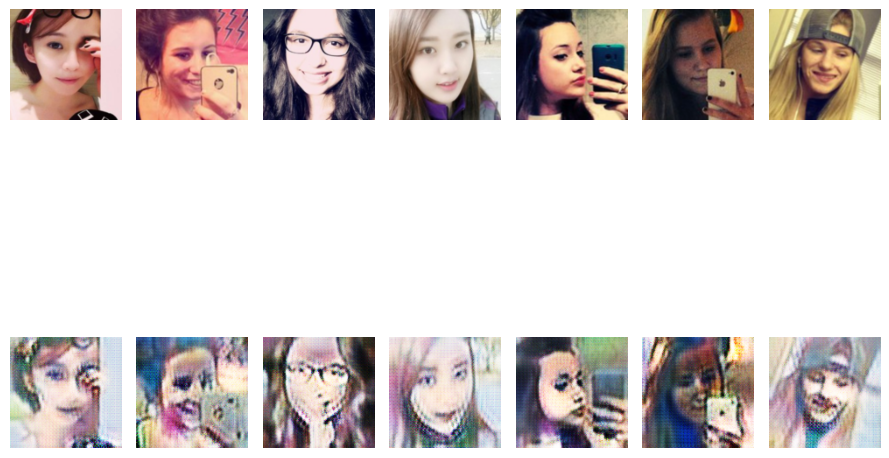

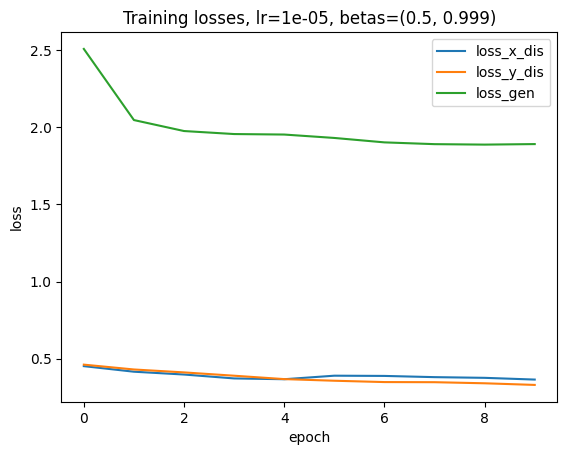

107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.39s/it]
107it [04:16,  2.40s/it]
107it [04:16,  2.40s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]


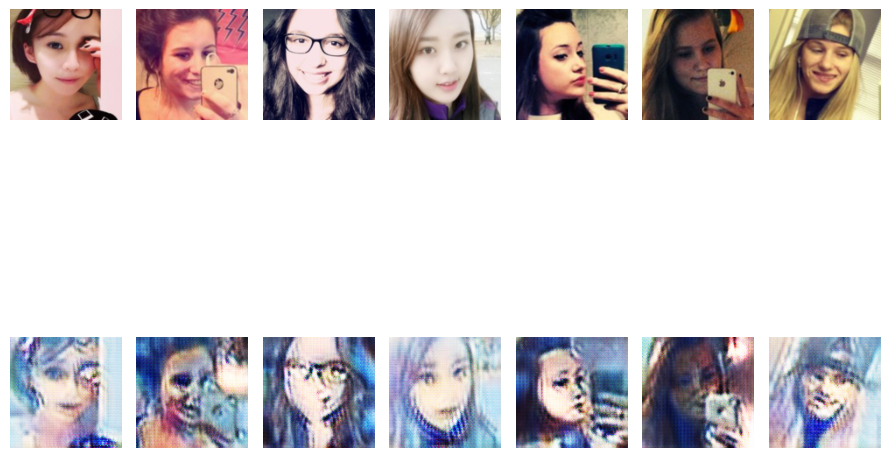

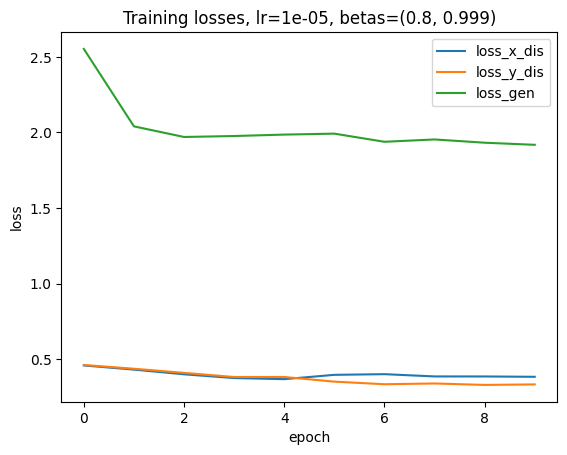

107it [04:16,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.37s/it]
107it [04:13,  2.37s/it]


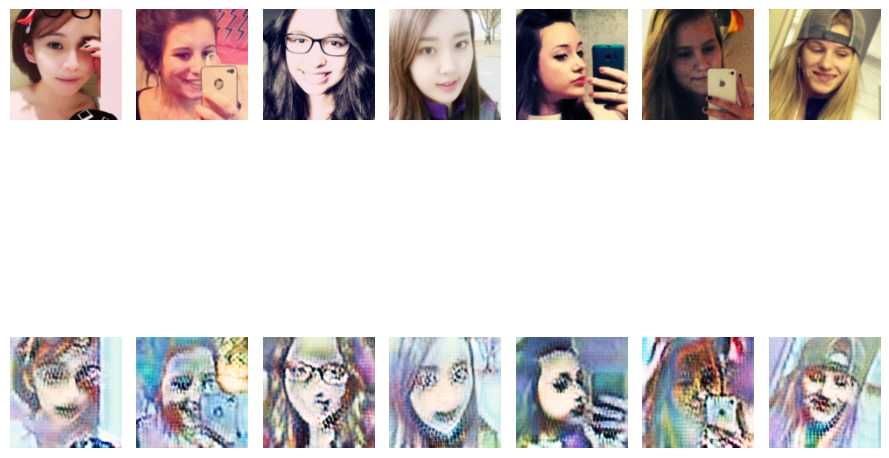

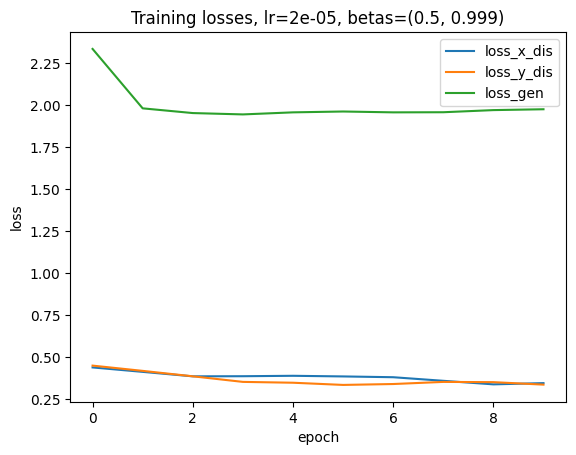

107it [04:14,  2.38s/it]
107it [04:15,  2.39s/it]
107it [04:15,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.39s/it]
107it [04:15,  2.39s/it]
107it [04:15,  2.39s/it]
107it [04:15,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]


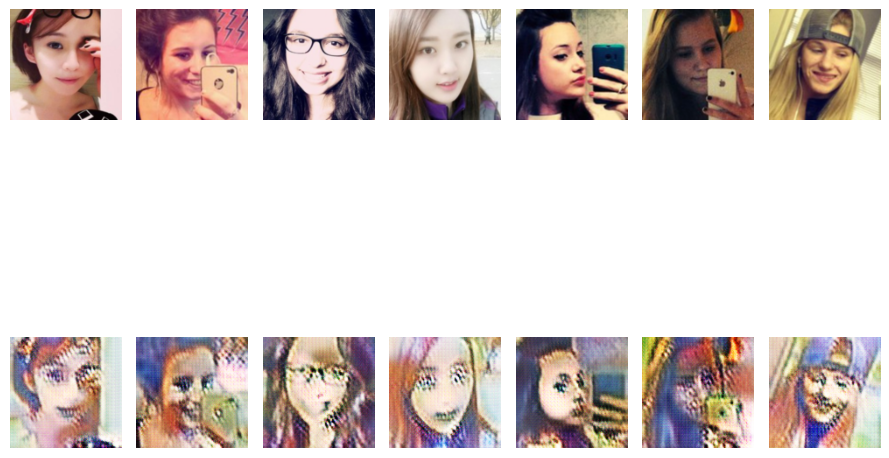

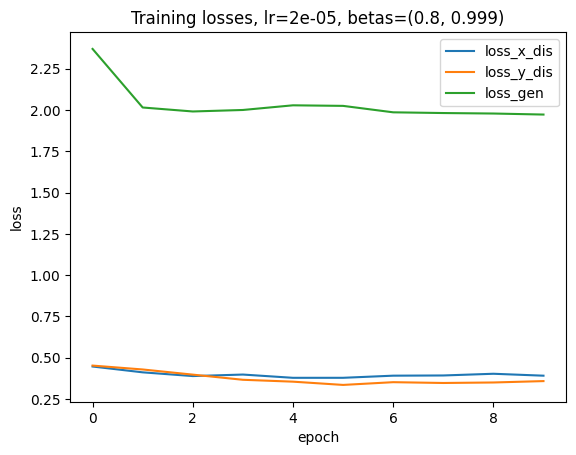

107it [04:15,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]


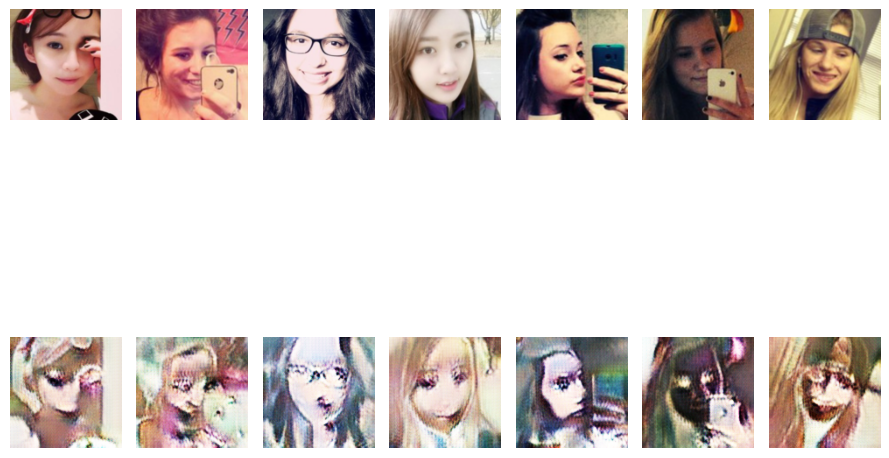

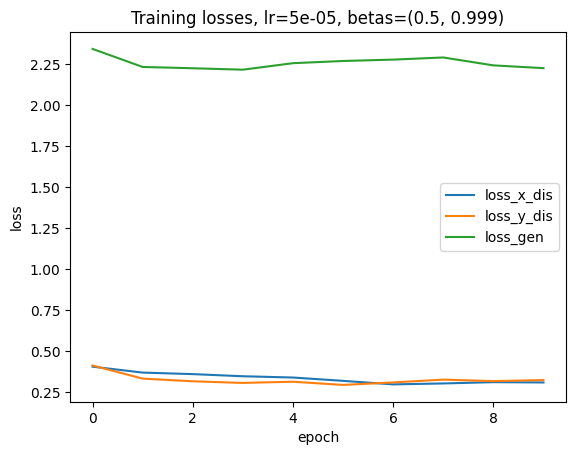

107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]


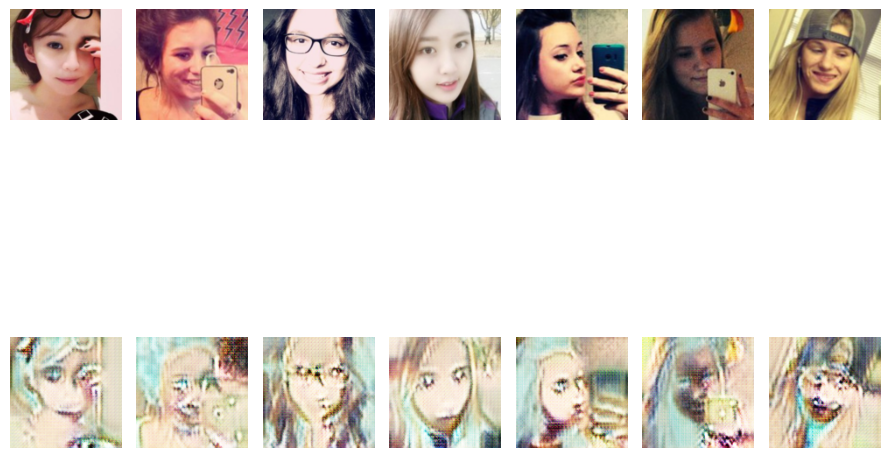

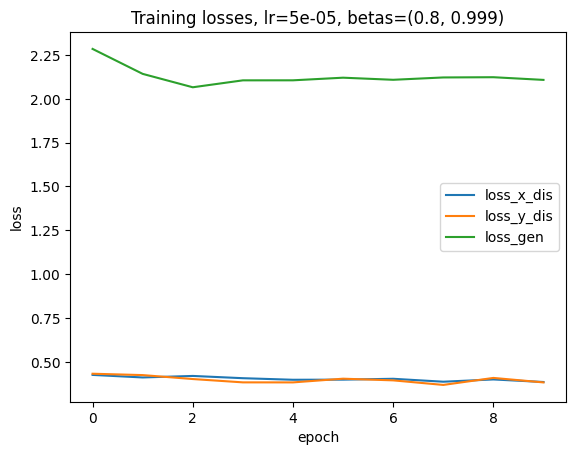

107it [04:13,  2.37s/it]
107it [04:15,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:17,  2.40s/it]
107it [04:14,  2.38s/it]
107it [04:17,  2.41s/it]
107it [04:19,  2.43s/it]
107it [04:19,  2.42s/it]
107it [04:16,  2.39s/it]
107it [04:15,  2.39s/it]


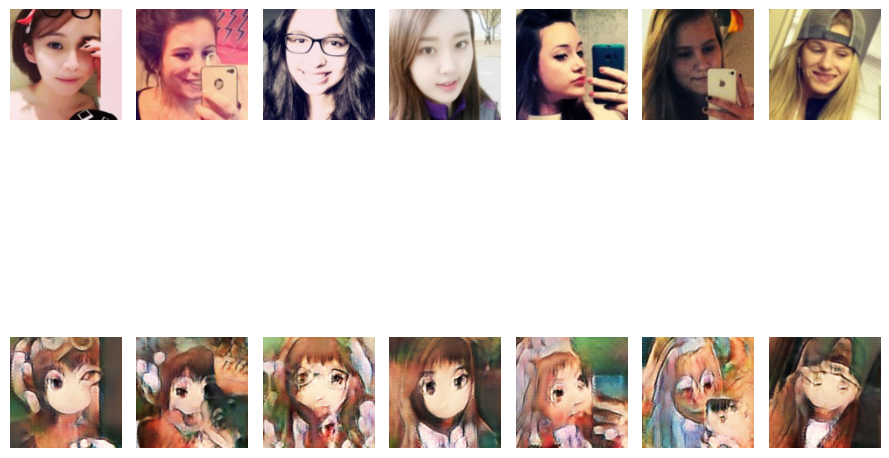

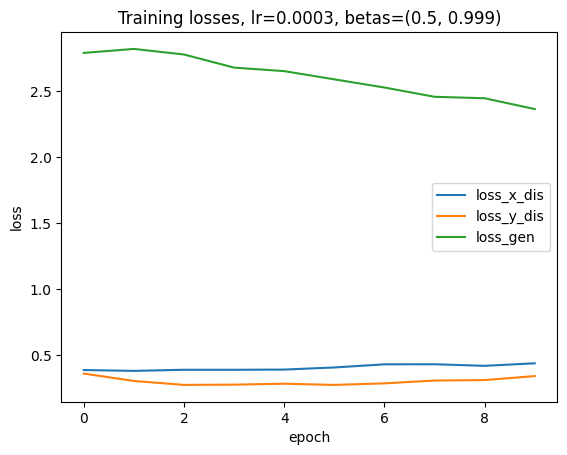

107it [04:17,  2.41s/it]
107it [04:15,  2.39s/it]
107it [04:17,  2.41s/it]
107it [04:16,  2.40s/it]
107it [04:17,  2.40s/it]
107it [04:16,  2.39s/it]
107it [04:17,  2.40s/it]
107it [04:20,  2.43s/it]
107it [04:18,  2.42s/it]
107it [04:16,  2.39s/it]


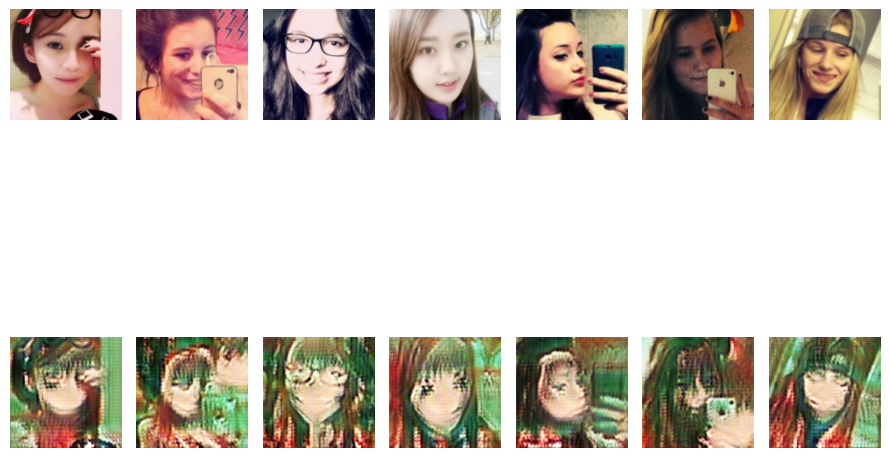

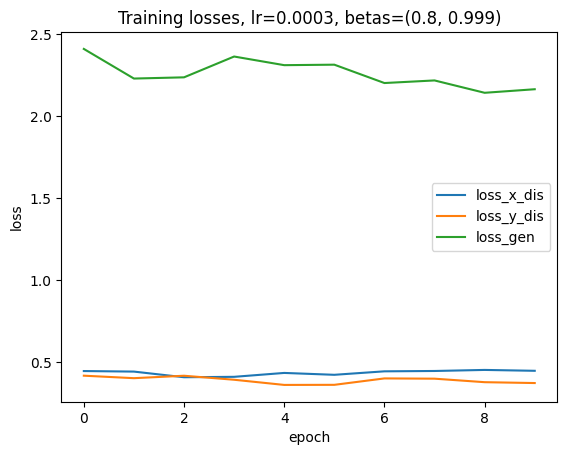

107it [04:16,  2.40s/it]
107it [04:15,  2.39s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]


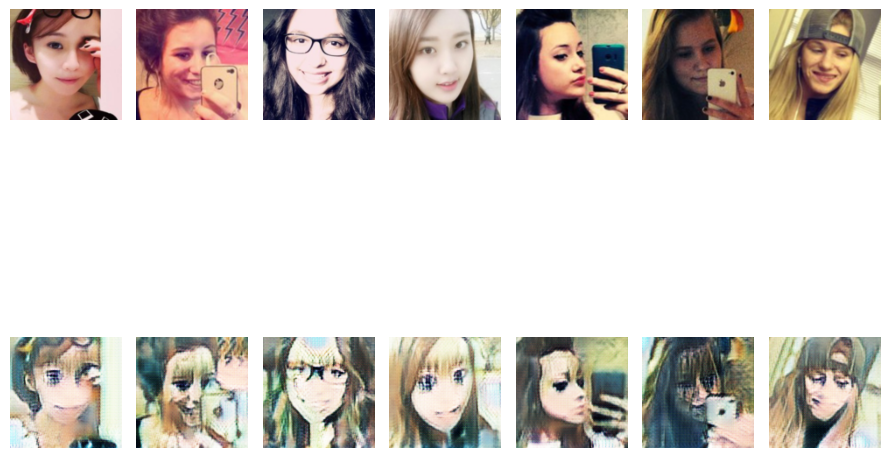

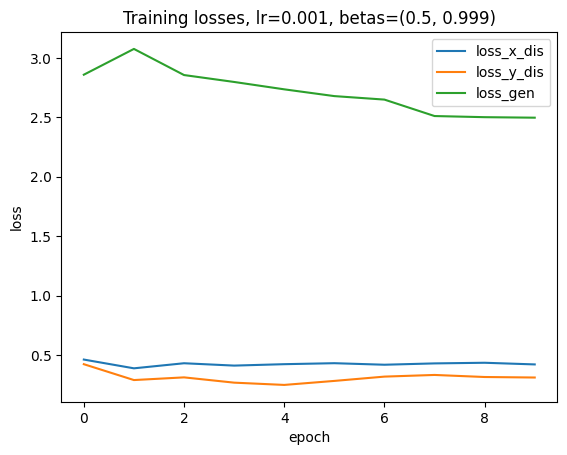

107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]


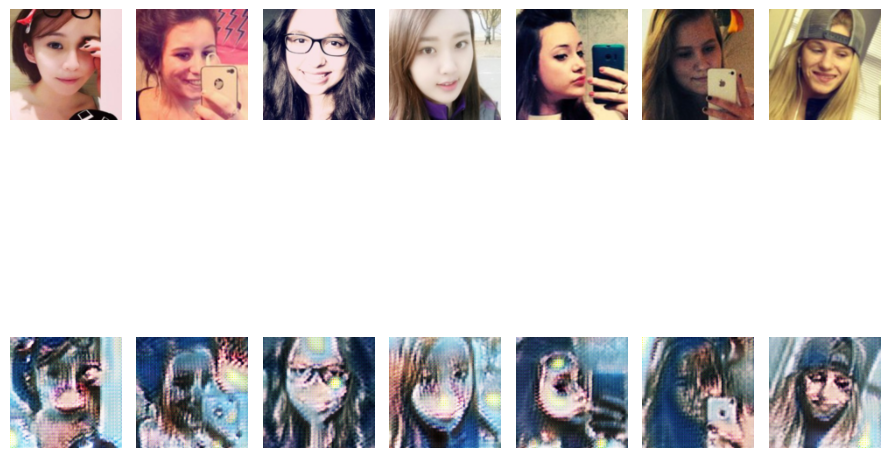

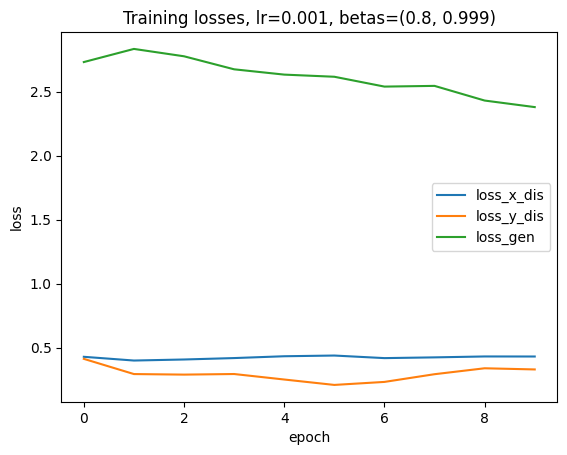

In [ ]:
epochs = 10
count = 0
for lr in lr_rates:
    for betas in betas_ar:
        count += 1
        model = CycleGAN(device, use_buffer=False)
        discriminator_params_x = list(model.dis_X.parameters())
        discriminator_params_y = list(model.dis_Y.parameters())

        generator_params = (
                list(model.gen_XY.parameters()) + list(model.gen_YX.parameters())
        )
        optimizers = {
            'discriminator_x': torch.optim.Adam(
                discriminator_params_x, lr=lr, betas=betas
            ),
            'discriminator_y': torch.optim.Adam(
                discriminator_params_y, lr=lr, betas=betas
            ),
            'generator': torch.optim.Adam(
                generator_params, lr=lr, betas=betas
            )
        }

        losses = model.train(epochs, 1e10, optimizers, loader_x, loader_y, female_test, anime_test, show_images=False)
        save_dir = f'/kaggle/working/experiments/model_{count}'
        try:
            model.save_weights(save_dir)
        except FileExistsError:
            print(
                f'Unable to save model on iteration {count}: ',
                f'dir {save_dir} already exists'
            )

        num_img = 7
        fig, ax = plt.subplots(2, num_img, figsize=(9, 9))
        for i in range(num_img):
            image_x = female_test[i]
            generated_y = model.gen_XY(image_x.to(device))
            ax[0][i].imshow(process_img_to_show(image_x))
            ax[0][i].axis('off')
            ax[1][i].imshow(process_img_to_show(generated_y))
            ax[1][i].axis('off')

        fig.tight_layout()
        plt.show()

        for loss_type in losses:
            plt.plot(losses[loss_type], label=loss_type)

        plt.title(f'Training losses, lr={lr}, betas={betas}')
        plt.xlabel('epoch')
        plt.ylabel('loss')
        plt.legend()
        plt.show()


The best results are with lr = 0.0003 and betas = (0.5, 0.999)

## Buffer

107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:14,  2.38s/it]


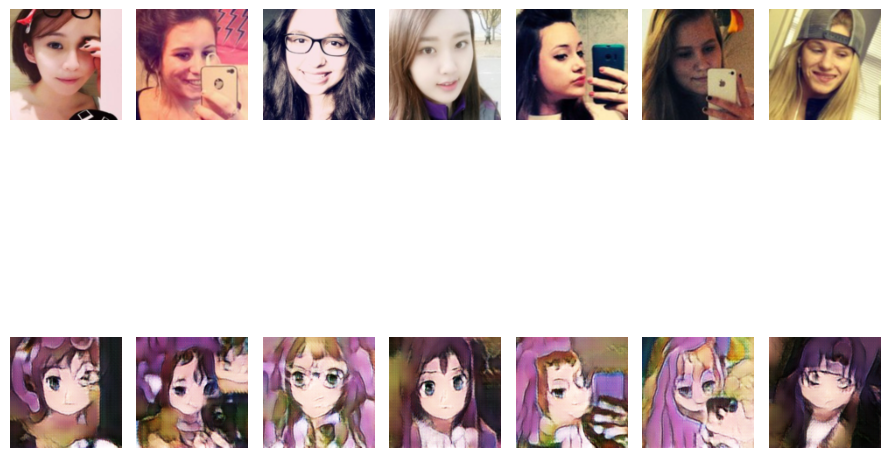

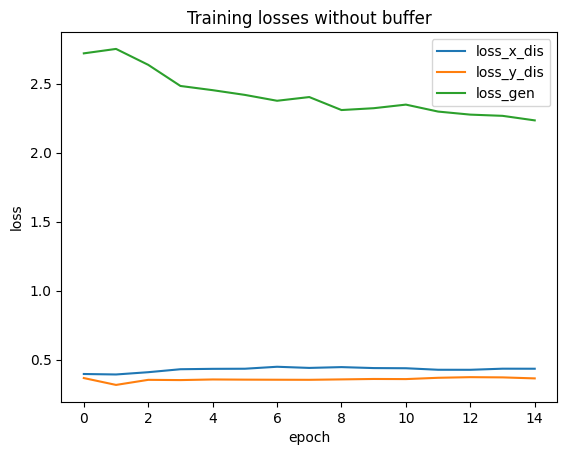

In [ ]:
epochs = 15

model = CycleGAN(device, use_buffer=False)
discriminator_params_x = list(model.dis_X.parameters())
discriminator_params_y = list(model.dis_Y.parameters())

generator_params = (
    list(model.gen_XY.parameters()) + list(model.gen_YX.parameters())
)
optimizers = {
    'discriminator_x': torch.optim.Adam(
        discriminator_params_x, lr=0.0003, betas=(0.5, 0.999)
    ),
    'discriminator_y': torch.optim.Adam(
        discriminator_params_y, lr=0.0003, betas=(0.5, 0.999)
    ),
    'generator': torch.optim.Adam(
        generator_params, lr=0.0003, betas=(0.5, 0.999)
    )
}

losses = model.train(epochs, 1e10, optimizers, loader_x, loader_y, female_test, anime_test, show_images=False)
save_dir = f'/kaggle/working/experiments/model_no_buffer'
try:
    model.save_weights(save_dir)
except FileExistsError:
    print(
        f'Unable to save model',
        f'dir {save_dir} already exists'
    )

num_img = 7
fig, ax = plt.subplots(2, num_img, figsize=(9, 9))
for i in range(num_img):
    image_x = female_test[i]
    generated_y = model.gen_XY(image_x.to(device))
    ax[0][i].imshow(process_img_to_show(image_x))
    ax[0][i].axis('off')
    ax[1][i].imshow(process_img_to_show(generated_y))
    ax[1][i].axis('off')

fig.tight_layout()
plt.show()

for loss_type in losses:
    plt.plot(losses[loss_type], label=loss_type)

plt.title(f'Training losses without buffer')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()


107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:13,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:15,  2.39s/it]
107it [04:15,  2.39s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.37s/it]
107it [04:13,  2.37s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]
107it [04:14,  2.38s/it]


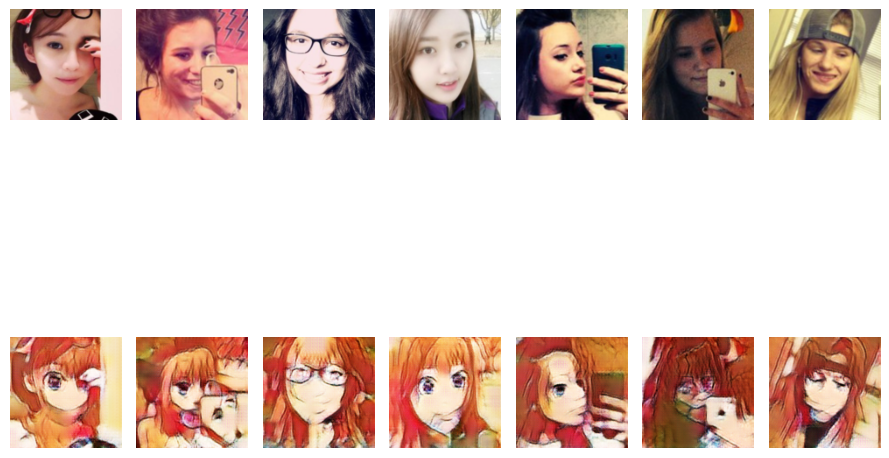

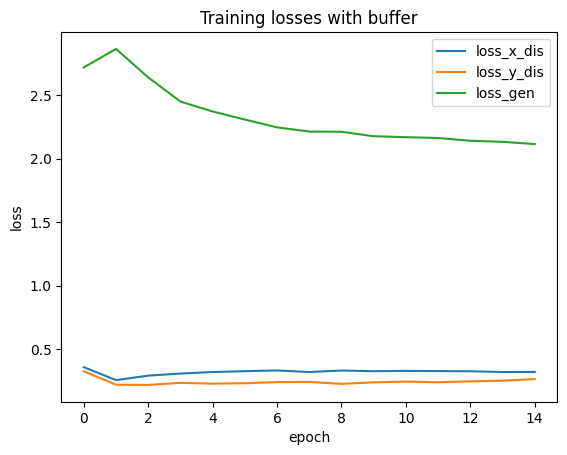

In [ ]:
epochs = 15

model = CycleGAN(device, use_buffer=True)
discriminator_params_x = list(model.dis_X.parameters())
discriminator_params_y = list(model.dis_Y.parameters())

generator_params = (
    list(model.gen_XY.parameters()) + list(model.gen_YX.parameters())
)
optimizers = {
    'discriminator_x': torch.optim.Adam(
        discriminator_params_x, lr=0.0003, betas=(0.5, 0.999)
    ),
    'discriminator_y': torch.optim.Adam(
        discriminator_params_y, lr=0.0003, betas=(0.5, 0.999)
    ),
    'generator': torch.optim.Adam(
        generator_params, lr=0.0003, betas=(0.5, 0.999)
    )
}

losses = model.train(epochs, 1e10, optimizers, loader_x, loader_y, female_test, anime_test, show_images=False)
save_dir = f'/kaggle/working/experiments/model_buffer'
try:
    model.save_weights(save_dir)
except FileExistsError:
    print(
        f'Unable to save model',
        f'dir {save_dir} already exists'
    )

num_img = 7
fig, ax = plt.subplots(2, num_img, figsize=(9, 9))
for i in range(num_img):
    image_x = female_test[i]
    generated_y = model.gen_XY(image_x.to(device))
    ax[0][i].imshow(process_img_to_show(image_x))
    ax[0][i].axis('off')
    ax[1][i].imshow(process_img_to_show(generated_y))
    ax[1][i].axis('off')

fig.tight_layout()
plt.show()

for loss_type in losses:
    plt.plot(losses[loss_type], label=loss_type)

plt.title(f'Training losses with buffer')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()


## Number of residuals layers

107it [05:08,  2.88s/it]
107it [05:07,  2.87s/it]
107it [05:09,  2.89s/it]
107it [05:08,  2.89s/it]
107it [05:08,  2.88s/it]
107it [05:08,  2.88s/it]
107it [05:07,  2.88s/it]
107it [05:08,  2.88s/it]
107it [05:08,  2.88s/it]
107it [05:08,  2.88s/it]
107it [05:08,  2.88s/it]
107it [05:09,  2.89s/it]
107it [05:09,  2.89s/it]
107it [05:09,  2.89s/it]
107it [05:08,  2.89s/it]


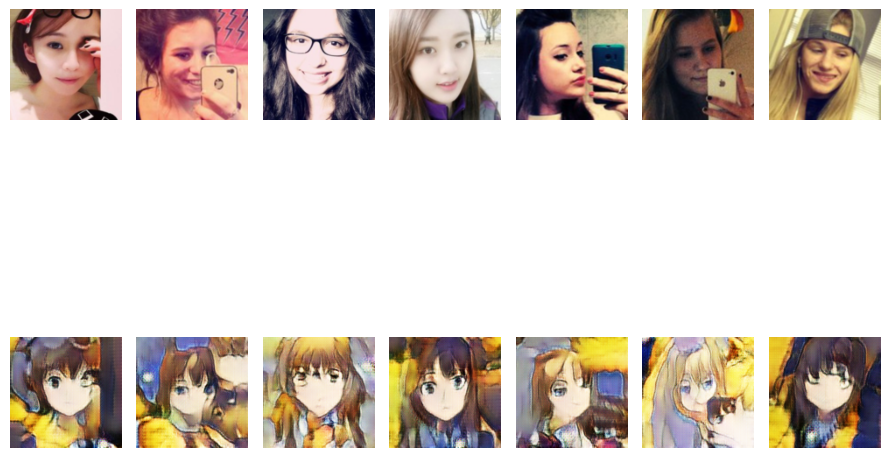

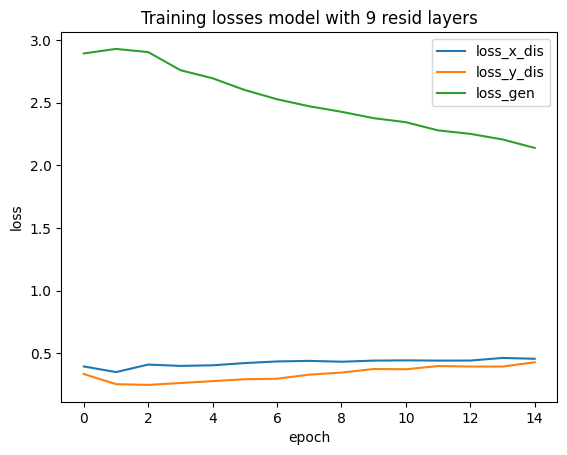

In [ ]:
epochs = 15

model = CycleGAN(device, num_resid=9, use_buffer=False)
discriminator_params_x = list(model.dis_X.parameters())
discriminator_params_y = list(model.dis_Y.parameters())

generator_params = (
    list(model.gen_XY.parameters()) + list(model.gen_YX.parameters())
)
optimizers = {
    'discriminator_x': torch.optim.Adam(
        discriminator_params_x, lr=0.0003, betas=(0.5, 0.999)
    ),
    'discriminator_y': torch.optim.Adam(
        discriminator_params_y, lr=0.0003, betas=(0.5, 0.999)
    ),
    'generator': torch.optim.Adam(
        generator_params, lr=0.0003, betas=(0.5, 0.999)
    )
}

losses = model.train(epochs, 1e10, optimizers, loader_x, loader_y, female_test, anime_test, show_images=False)
save_dir = f'/kaggle/working/experiments/model_9_resid'
try:
    model.save_weights(save_dir)
except FileExistsError:
    print(
        f'Unable to save model',
        f'dir {save_dir} already exists'
    )

num_img = 7
fig, ax = plt.subplots(2, num_img, figsize=(9, 9))
for i in range(num_img):
    image_x = female_test[i]
    generated_y = model.gen_XY(image_x.to(device))
    ax[0][i].imshow(process_img_to_show(image_x))
    ax[0][i].axis('off')
    ax[1][i].imshow(process_img_to_show(generated_y))
    ax[1][i].axis('off')

fig.tight_layout()
plt.show()

for loss_type in losses:
    plt.plot(losses[loss_type], label=loss_type)

plt.title(f'Training losses model with 9 resid layers')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()


# Training Final model

In [ ]:
epochs = 70

model = CycleGAN(device, use_buffer=False)
discriminator_params_x = list(model.dis_X.parameters())
discriminator_params_y = list(model.dis_Y.parameters())

generator_params = (
    list(model.gen_XY.parameters()) + list(model.gen_YX.parameters())
)
optimizers = {
    'discriminator_x': torch.optim.Adam(
        discriminator_params_x, lr=0.0003, betas=(0.5, 0.999)
    ),
    'discriminator_y': torch.optim.Adam(
        discriminator_params_y, lr=0.0003, betas=(0.5, 0.999)
    ),
    'generator': torch.optim.Adam(
        generator_params, lr=0.0003, betas=(0.5, 0.999)
    )
}



107it [05:08,  2.89s/it]


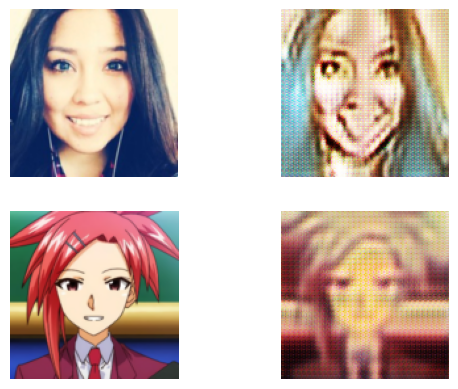

107it [04:18,  2.41s/it]


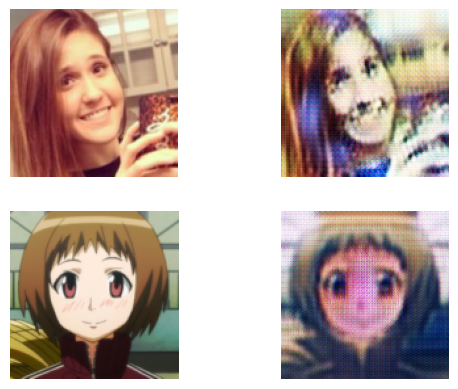

107it [04:15,  2.39s/it]


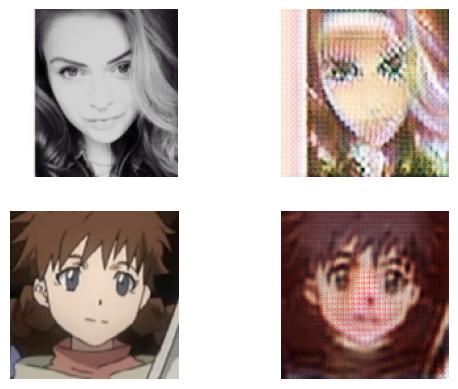

107it [04:16,  2.39s/it]


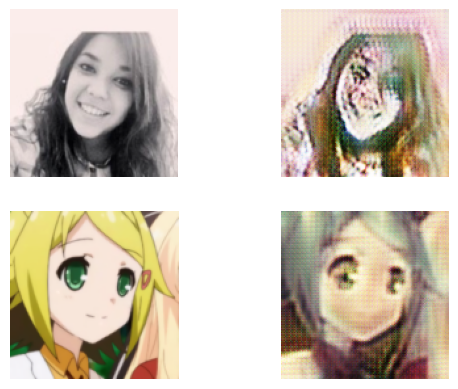

107it [04:15,  2.39s/it]


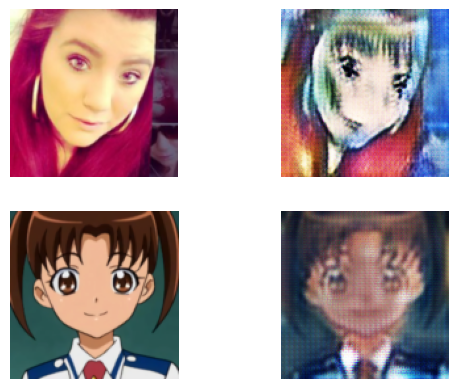

107it [04:15,  2.39s/it]


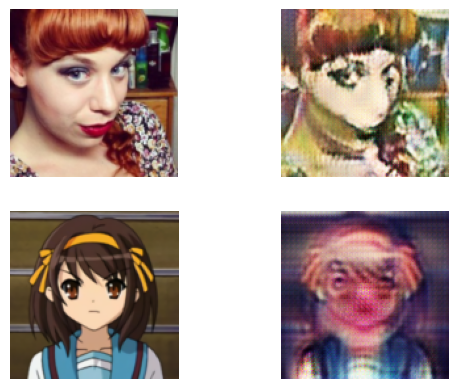

107it [04:16,  2.40s/it]


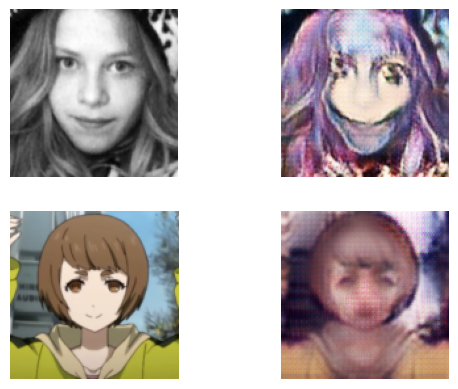

107it [04:17,  2.40s/it]


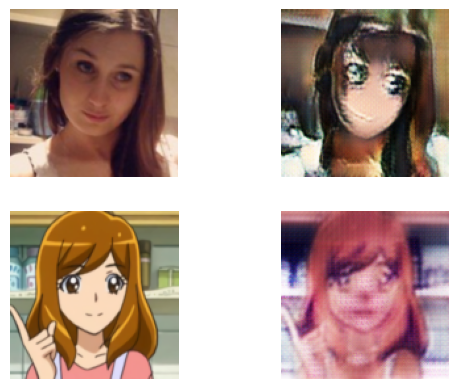

107it [04:17,  2.40s/it]


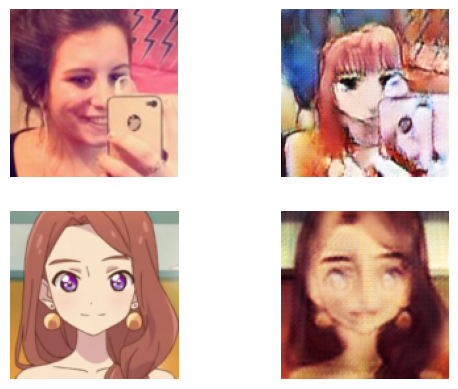

107it [04:25,  2.48s/it]


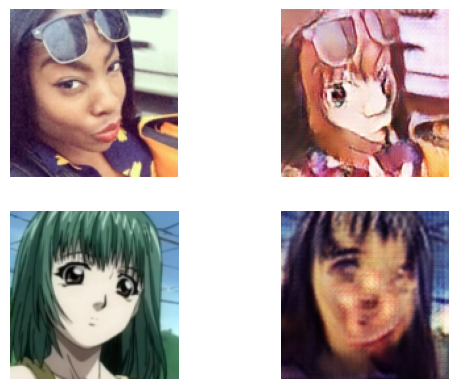

107it [04:19,  2.43s/it]


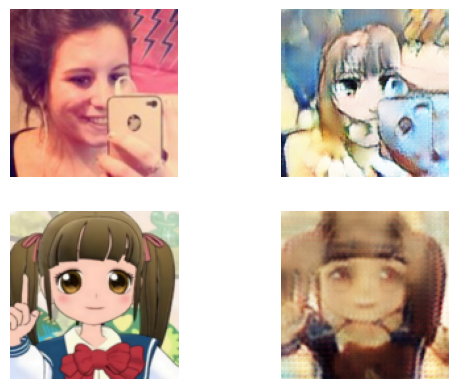

107it [04:29,  2.51s/it]


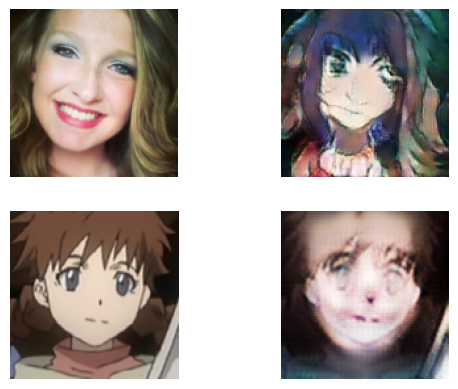

107it [04:16,  2.40s/it]


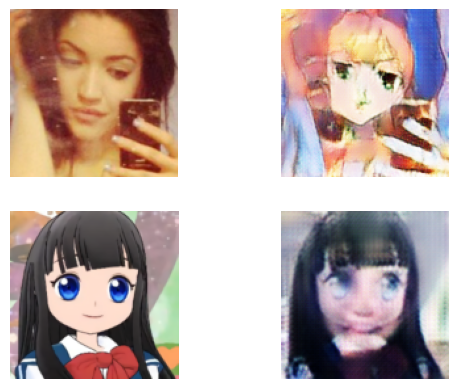

107it [04:16,  2.40s/it]


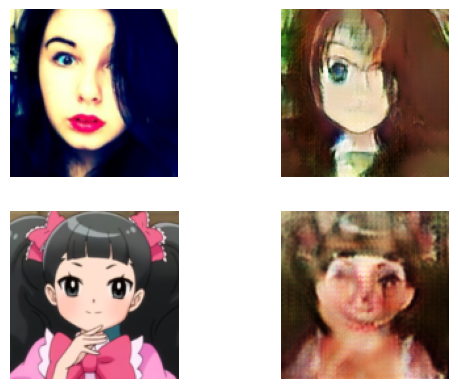

107it [04:16,  2.40s/it]


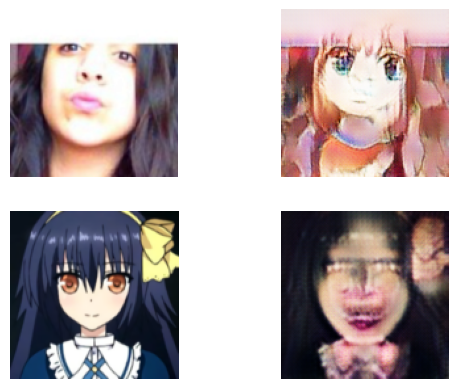

107it [04:16,  2.40s/it]


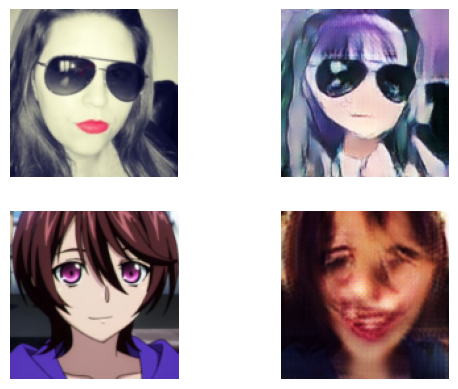

107it [04:16,  2.40s/it]


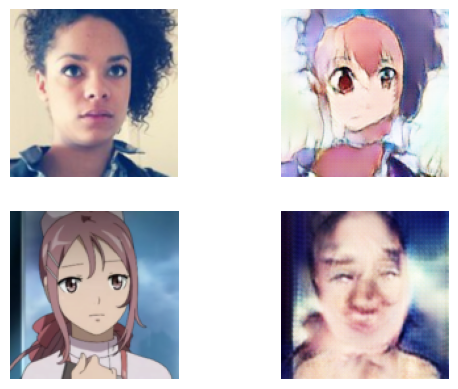

107it [04:18,  2.41s/it]


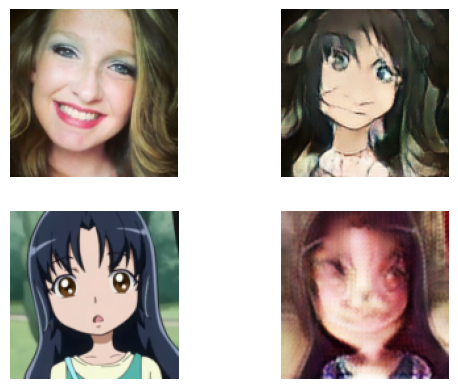

107it [04:17,  2.40s/it]


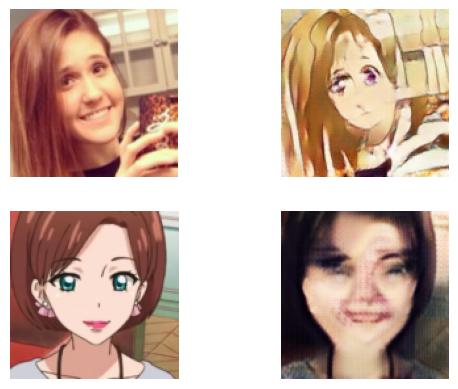

107it [04:17,  2.40s/it]


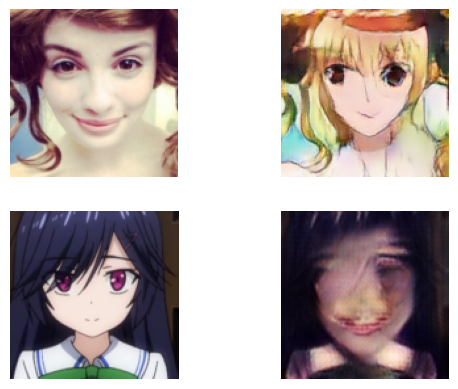

107it [04:17,  2.41s/it]


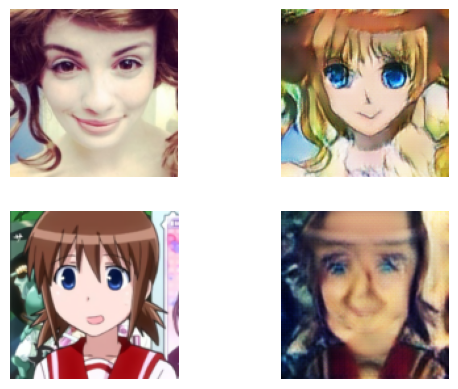

107it [04:19,  2.42s/it]


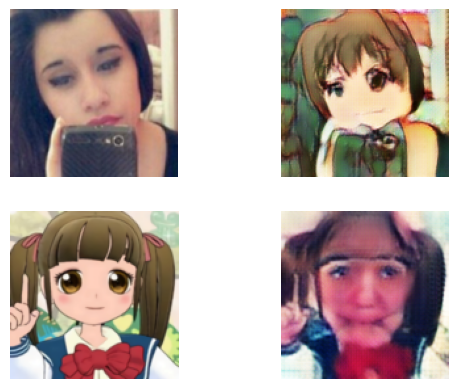

107it [04:17,  2.40s/it]


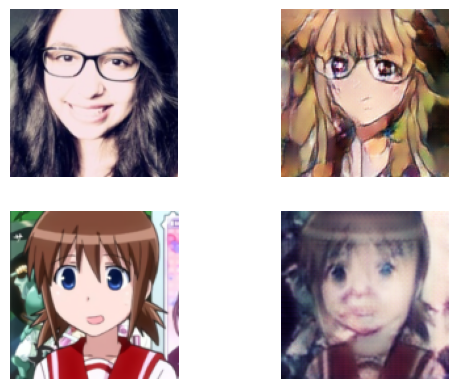

107it [04:15,  2.39s/it]


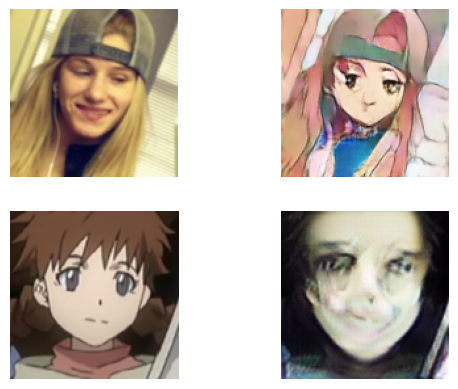

107it [04:15,  2.39s/it]


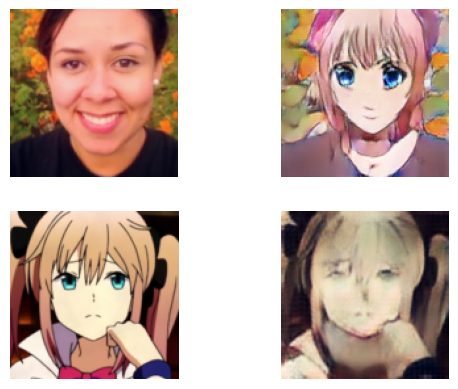

107it [04:19,  2.43s/it]


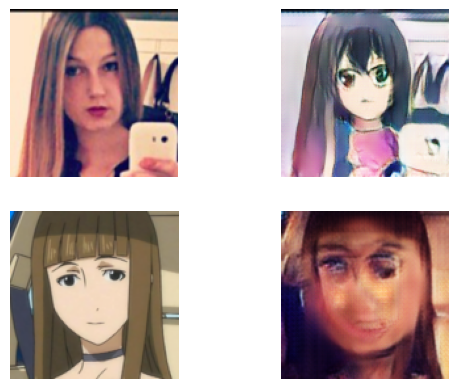

107it [04:23,  2.46s/it]


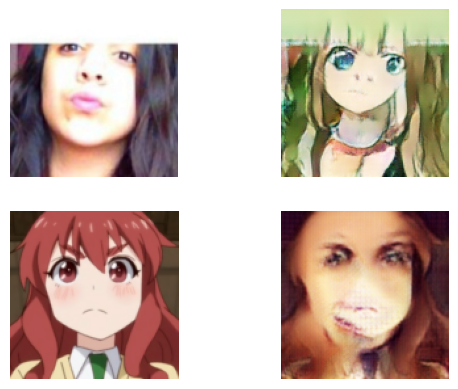

107it [04:19,  2.42s/it]


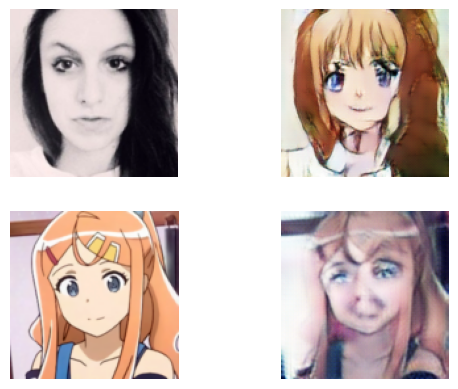

107it [04:28,  2.51s/it]


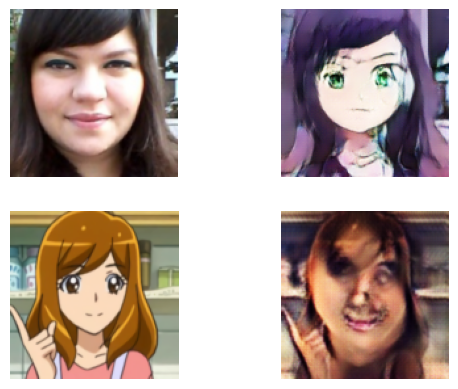

107it [04:16,  2.40s/it]


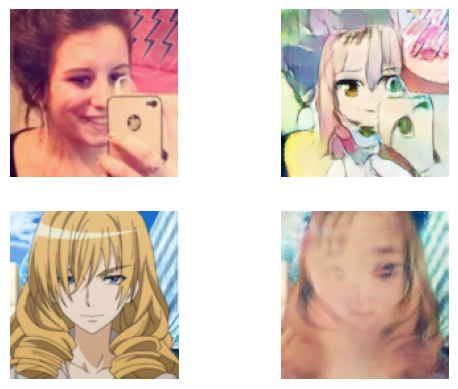

107it [04:28,  2.51s/it]


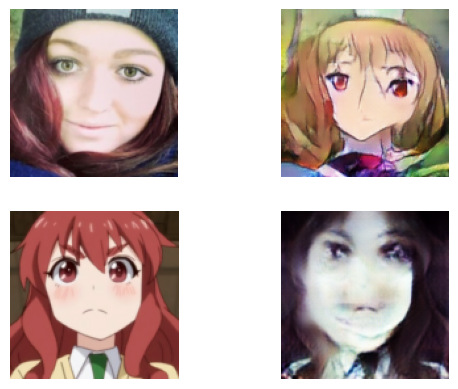

107it [04:18,  2.41s/it]


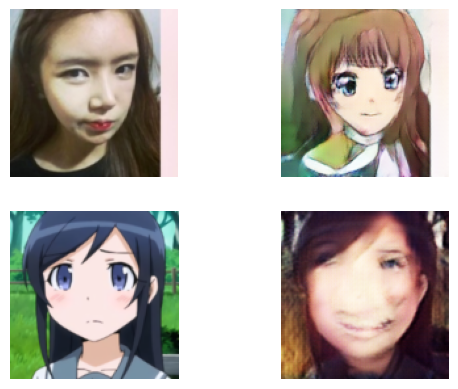

107it [04:16,  2.39s/it]


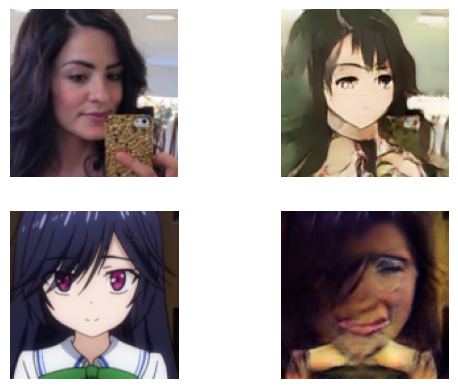

107it [04:17,  2.41s/it]


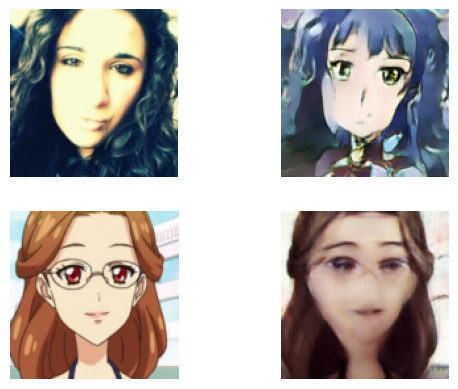

107it [04:18,  2.41s/it]


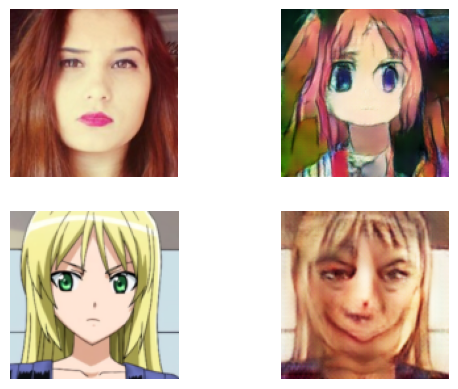

107it [04:16,  2.39s/it]


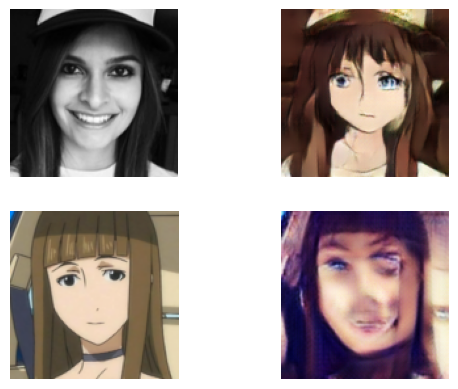

107it [04:24,  2.47s/it]


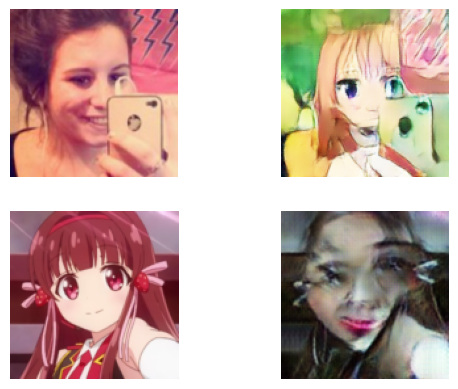

107it [04:16,  2.39s/it]


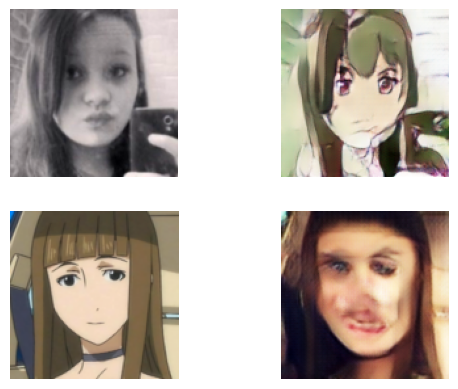

107it [04:15,  2.39s/it]


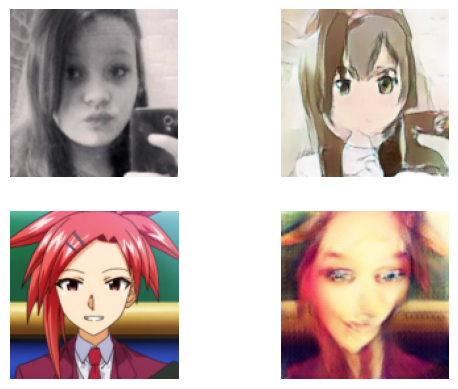

107it [04:16,  2.40s/it]


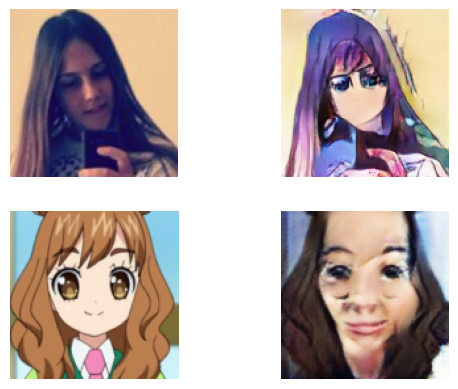

107it [04:16,  2.39s/it]


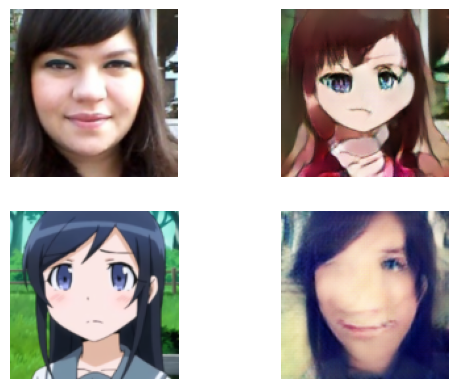

107it [04:17,  2.41s/it]


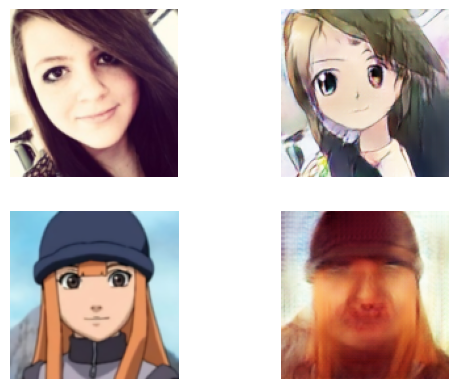

107it [04:19,  2.43s/it]


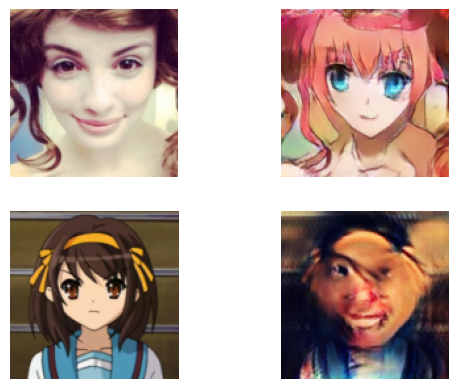

101it [04:03,  2.40s/it]


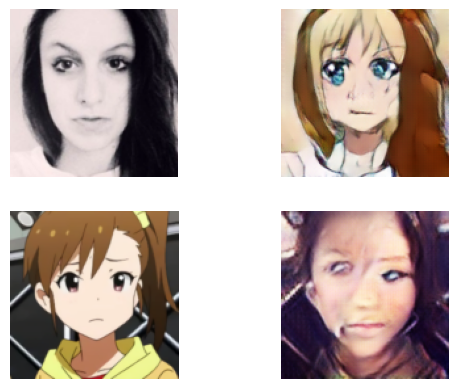

107it [04:16,  2.39s/it]


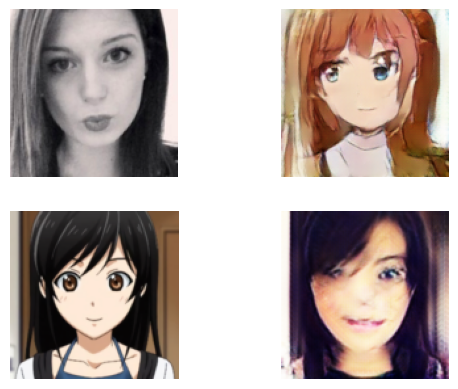

107it [04:18,  2.42s/it]


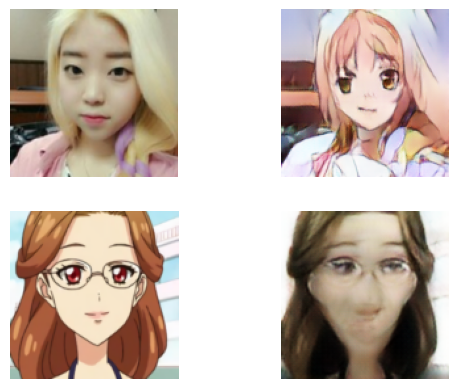

107it [04:21,  2.44s/it]


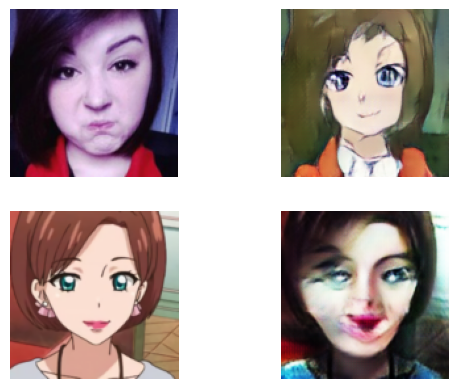

107it [04:15,  2.39s/it]


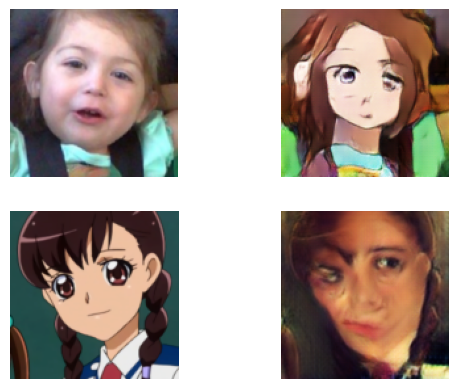

107it [04:16,  2.39s/it]


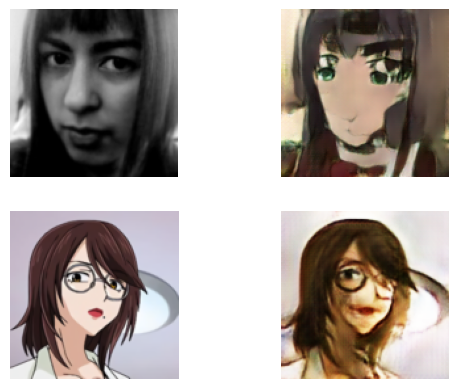

107it [04:16,  2.39s/it]


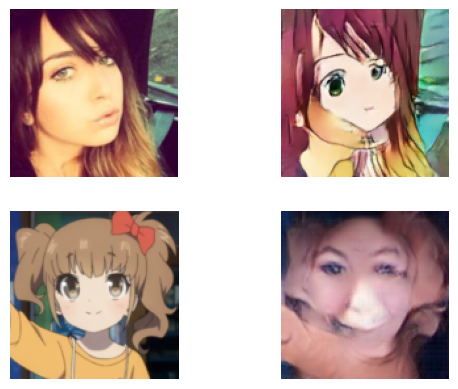

107it [04:18,  2.42s/it]


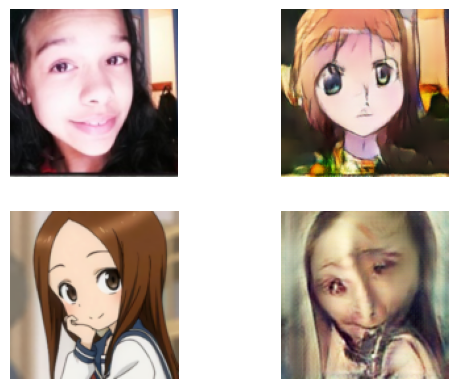

107it [04:17,  2.41s/it]


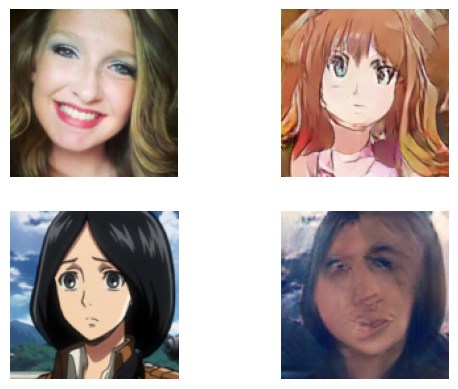

107it [04:18,  2.41s/it]


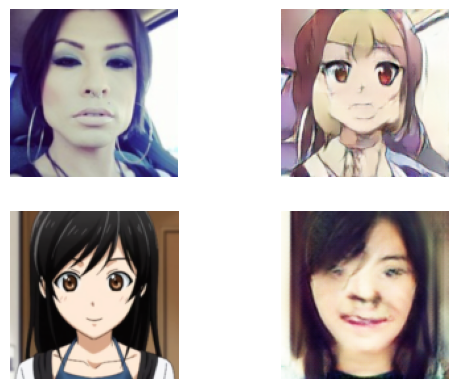

107it [04:17,  2.41s/it]


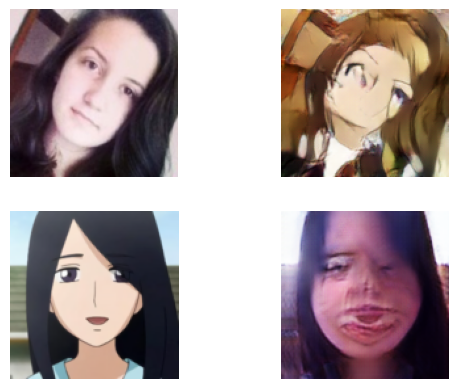

107it [04:17,  2.41s/it]


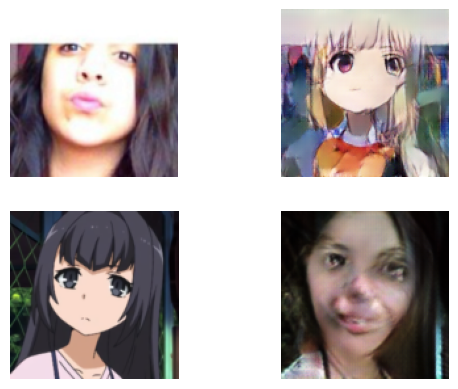

107it [04:25,  2.48s/it]


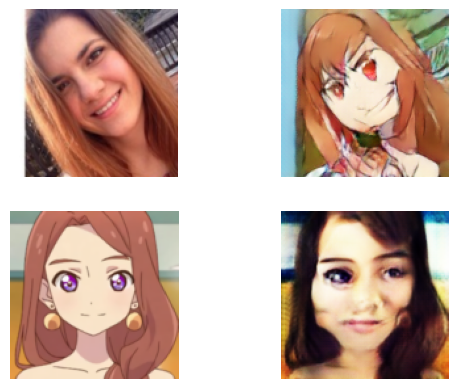

107it [04:24,  2.47s/it]


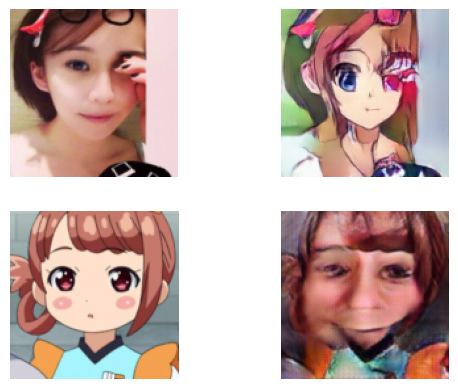

107it [04:16,  2.40s/it]


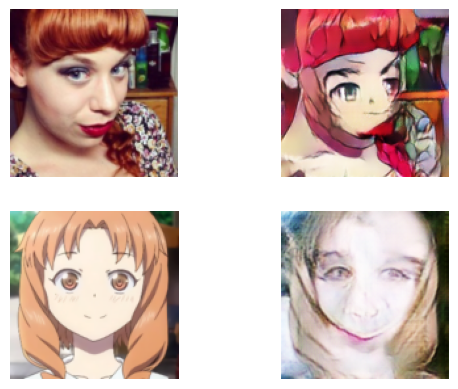

107it [04:16,  2.40s/it]


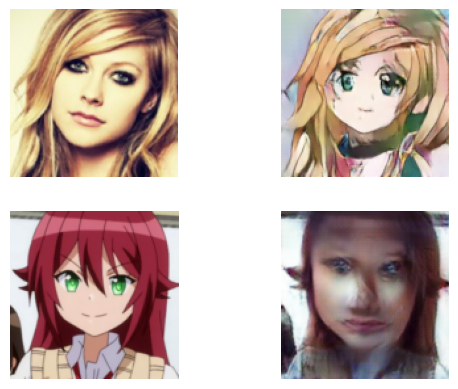

107it [04:16,  2.39s/it]


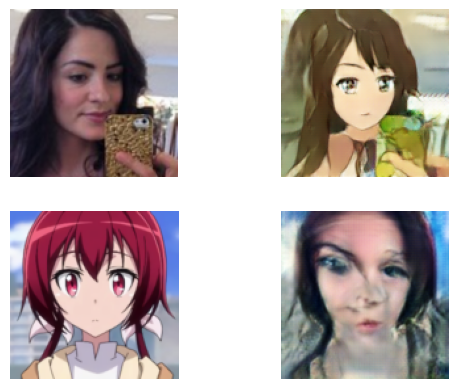

107it [04:15,  2.39s/it]


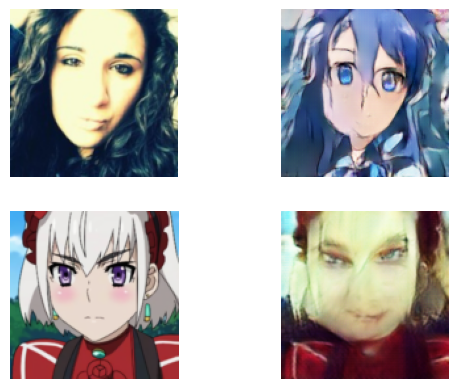

107it [04:17,  2.41s/it]


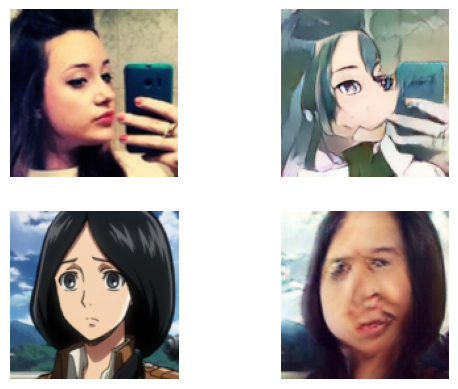

107it [04:16,  2.40s/it]


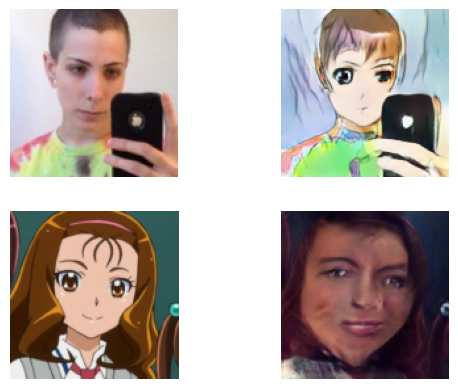

107it [04:17,  2.40s/it]


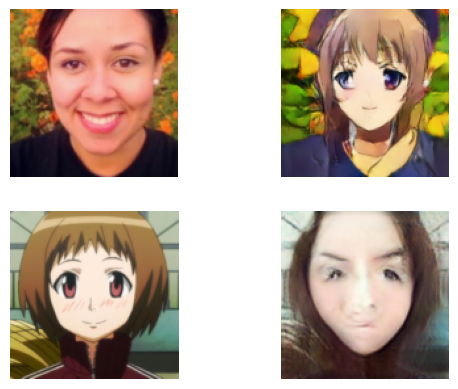

107it [04:18,  2.41s/it]


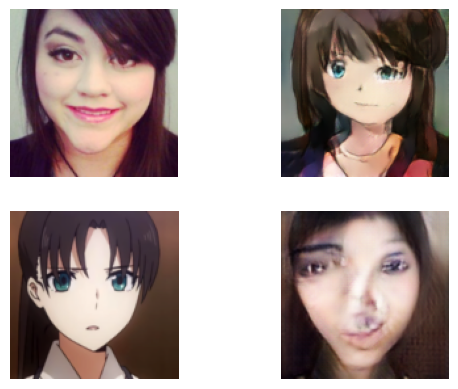

107it [04:20,  2.43s/it]


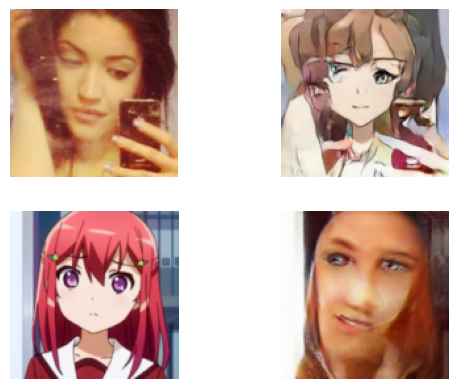

107it [04:16,  2.40s/it]


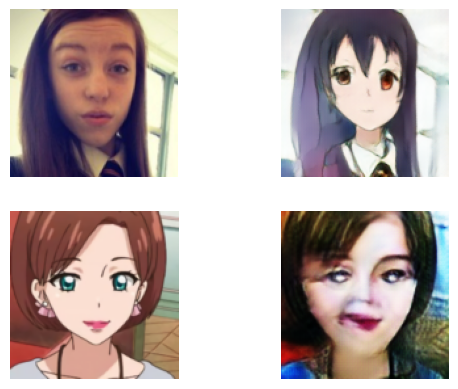

107it [04:16,  2.39s/it]


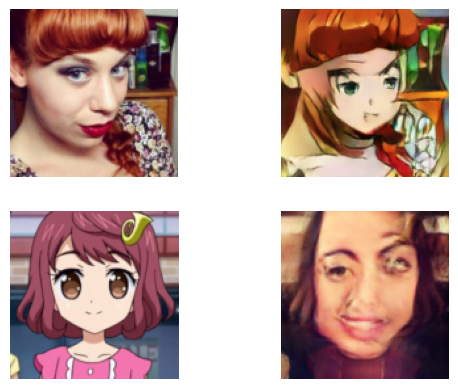

107it [04:16,  2.39s/it]


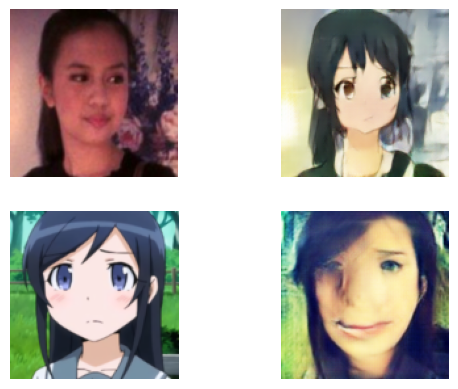

107it [04:21,  2.45s/it]


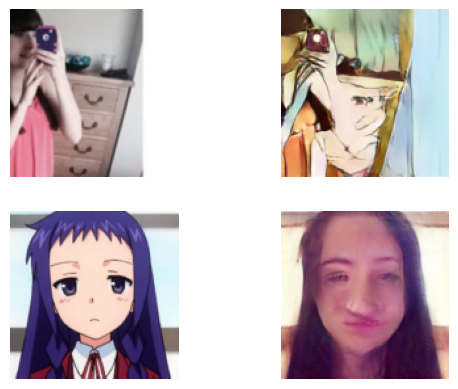

In [ ]:
losses = model.train(epochs, 5, optimizers, loader_x, loader_y, female_test, anime_test)

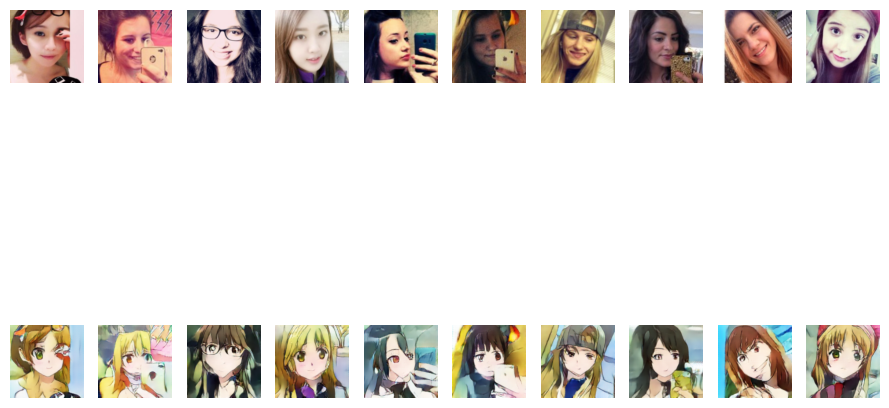

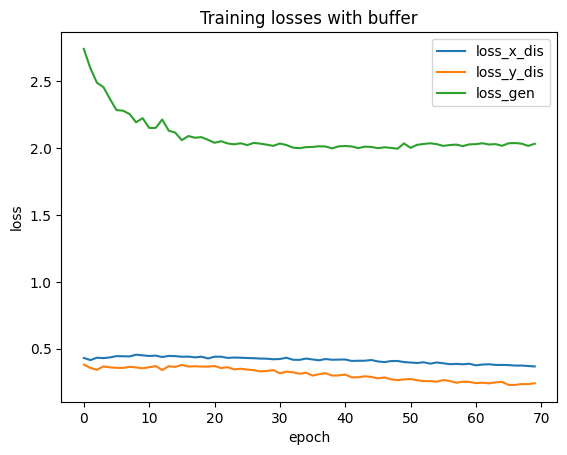

In [ ]:
num_img = 10
fig, ax = plt.subplots(2, num_img, figsize=(9, 9))
for i in range(num_img):
    image_x = female_test[i]
    generated_y = model.gen_XY(image_x.to(device))
    ax[0][i].imshow(process_img_to_show(image_x))
    ax[0][i].axis('off')
    ax[1][i].imshow(process_img_to_show(generated_y))
    ax[1][i].axis('off')

fig.tight_layout()
plt.show()

for loss_type in losses:
    plt.plot(losses[loss_type], label=loss_type)

plt.title(f'Training losses with buffer')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.show()